In [ ]:
from google.colab import drive
drive.mount("content/")

Drive already mounted at content/; to attempt to forcibly remount, call drive.mount("content/", force_remount=True).


In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np

In [ ]:
def get_pyramid(image,pyramid_level,kernel,sampling_mode):
  """
  Parameters:

     image=Input image 
     pyramid_level: Number of levels of the output pyramid, first level being the original image
     kernel: A matrix to be used for convolution
     sampling_mode: "up"=upsampling and "down"=downsampling


  """
  pyramid={}
  if sampling_mode=="up":
    pyramid[0]=image
    for level in range(1,pyramid_level):
      pyramid[level]=4*cv.filter2D(upsampling(upsampling(pyramid[level-1],0),1),-1,kernel)# 4 is multiplied to enhance the intensity of the image since after upsampling, since there will be a lot of rows and columns having only zeros
  elif sampling_mode=="down":
    pyramid[0]=image
    for level in range(1,pyramid_level):
      pyramid[level]=downsampling(downsampling(cv.filter2D(pyramid[level-1],-1,kernel),0),1)
  return pyramid  

In [ ]:
def upsampling(image,axis):
  """
  Parameters:

      image: Input image
      axis: axis along which the image is to expanded (rows or columns)

  """
  sampled_image=[]
  try:
    channels=image.shape[2]
    for channel_num in range(channels):
      count=0
      for index in range(image.shape[axis]): 
          if index==0:
            up_sample=np.insert(image[:,:,channel_num], index, np.zeros(image.shape[1-axis]), axis)  
          else:
            up_sample=np.insert(up_sample,index+count,np.zeros(image.shape[1-axis]),axis)
          count+=1
      sampled_image.append(up_sample)
    return cv.merge(sampled_image)

  except IndexError:# For gray scale image input
    count=0
    for index in range(image.shape[axis]): 
        if index==0:
          up_sample=np.insert(image, index, np.zeros(image.shape[1-axis]), axis)  
        else:
          up_sample=np.insert(up_sample,index+count,np.zeros(image.shape[1-axis]),axis)
        count+=1
    return up_sample

In [ ]:
def downsampling(image,axis):
  """
  Parameters:

      image: Input image
      axis: axis along which the image is to be reduced, rows or columns

  """
  sampled_image=[]
  try:
    channels=image.shape[2]
    if axis==0:    
      for channel_num in range(channels):
          down_sample=np.delete(image[:,:,channel_num], list(range(0,image.shape[axis],2)),axis) 
          sampled_image.append(down_sample)
    elif axis==1:
      for channel_num in range(channels):
          down_sample=np.delete(image[:,:,channel_num],np.s_[::2], axis) 
          sampled_image.append(down_sample)
    return cv.merge(sampled_image)

  except IndexError:# For gray scale image input
    if axis==0:    
          down_sample=np.delete(image, list(range(0,image.shape[axis],2)),axis) 
          sampled_image.append(down_sample)
    elif axis==1:
          down_sample=np.delete(image,np.s_[::2], axis) 
    return down_sample

#### Note:

For cases such as we have an image of height say 225, which when we downsample wil become 112 and when again upsampled we have an image of height 224, in which case we cannot perform addition or subtraction of an image from the upsampled form of its image in the level just below the level of the  actual image of the pyramid. Hence here we perform padding to do the adjustments wherever needed.

In [ ]:
def Laplacian_pyramid(gaussian_pyramid,kernel):
  """
  Parameters:

      gaussian_pyramid: Pyramid on performing convolutions using gaussian kernel
      kernel: A matrix to be used for convolution

  """


  laplacian_pyramid={}
  for key in list(gaussian_pyramid.keys())[::-1][1:]:

    if gaussian_pyramid[key].shape[0]>upsampling(upsampling(gaussian_pyramid[key+1],0),1).shape[0] :

      if gaussian_pyramid[key].shape[1]>upsampling(upsampling(gaussian_pyramid[key+1],0),1).shape[1]:
        laplacian_pyramid[key]=gaussian_pyramid[key]-4*cv.copyMakeBorder(cv.filter2D(upsampling(upsampling(gaussian_pyramid[key+1],0),1),-1,kernel),1,0,1,0,cv.BORDER_REPLICATE)
      
      else:
        laplacian_pyramid[key]=gaussian_pyramid[key]-4*cv.copyMakeBorder(cv.filter2D(upsampling(upsampling(gaussian_pyramid[key+1],0),1),-1,kernel),1,0,0,0,cv.BORDER_REPLICATE)
    
    elif gaussian_pyramid[key].shape[1]>upsampling(upsampling(gaussian_pyramid[key+1],0),1).shape[1] and gaussian_pyramid[key].shape[0]==upsampling(upsampling(gaussian_pyramid[key+1],0),1).shape[0] :
        laplacian_pyramid[key]=gaussian_pyramid[key]-4*cv.copyMakeBorder(cv.filter2D(upsampling(upsampling(gaussian_pyramid[key+1],0),1),-1,kernel),0,0,1,0,cv.BORDER_REPLICATE)

    else:
      laplacian_pyramid[key]=gaussian_pyramid[key]-4*cv.filter2D(upsampling(upsampling(gaussian_pyramid[key+1],0),1),-1,kernel)
      
  return laplacian_pyramid 

In [ ]:
def reconstruct_original(gaussian_pyramid,Laplacian_pyramid,kernel):
  """
  Parameters:

      gaussian_pyramid: Pyramid on performing convolutions using gaussian kernel
      Laplacian_pyramid:Pyramid on performing convolutions using gaussian kernel
      kernel: A matrix to be used for convolution
      
  """

  reconstruct={}
  for key in list(gaussian_pyramid.keys())[::-1][:len(gaussian_pyramid)-1]:
      if upsampling(upsampling(gaussian_pyramid[key],0),1).shape[0]<Laplacian_pyramid[key-1].shape[0]:
        
        if upsampling(upsampling(gaussian_pyramid[key],0),1).shape[1]<Laplacian_pyramid[key-1].shape[1]:
          reconstruct[key]=cv.copyMakeBorder(4*cv.filter2D(upsampling(upsampling(gaussian_pyramid[key],0),1),-1,kernel),1,0,1,0,cv.BORDER_REPLICATE)+Laplacian_pyramid[key-1]

        else:
          reconstruct[key]=cv.copyMakeBorder(4*cv.filter2D(upsampling(upsampling(gaussian_pyramid[key],0),1),-1,kernel),1,0,0,0,cv.BORDER_REPLICATE)+Laplacian_pyramid[key-1]
      
      elif upsampling(upsampling(gaussian_pyramid[key],0),1).shape[1]<Laplacian_pyramid[key-1].shape[1] and upsampling(upsampling(gaussian_pyramid[key],0),1).shape[0]==Laplacian_pyramid[key-1].shape[0]:
          reconstruct[key]=cv.copyMakeBorder(4*cv.filter2D(upsampling(upsampling(gaussian_pyramid[key],0),1),-1,kernel),0,0,1,0,cv.BORDER_REPLICATE)+Laplacian_pyramid[key-1]
      
      else:
        reconstruct[key]=4*cv.filter2D(upsampling(upsampling(gaussian_pyramid[key],0),1),-1,kernel)+Laplacian_pyramid[key-1]

  return reconstruct

In [ ]:
def compare_image(image1,image2):
  """
  Parameters:

      image1:Input image 1
      image2:Input image 2 

  """

  diff=image1-image2
  if sum([abs(pixel) for pixel in diff.ravel()])==0:
    return True
  else:
    return False

In [ ]:
gauss_kernel=np.outer((1/16)*np.array([[1,4,6,4,1]]),(1/16)*np.array([[1,4,6,4,1]]))# A gaussian kernel used for convolutions performed below

In [ ]:
gauss_kernel

array([[0.00390625, 0.015625  , 0.0234375 , 0.015625  , 0.00390625],
       [0.015625  , 0.0625    , 0.09375   , 0.0625    , 0.015625  ],
       [0.0234375 , 0.09375   , 0.140625  , 0.09375   , 0.0234375 ],
       [0.015625  , 0.0625    , 0.09375   , 0.0625    , 0.015625  ],
       [0.00390625, 0.015625  , 0.0234375 , 0.015625  , 0.00390625]])

## *Lena*

In [ ]:
Lena=cv.imread("/content/content/My Drive/Data/Images/Pyramids/lena.png")

In [ ]:
Lena.shape

(512, 512, 3)

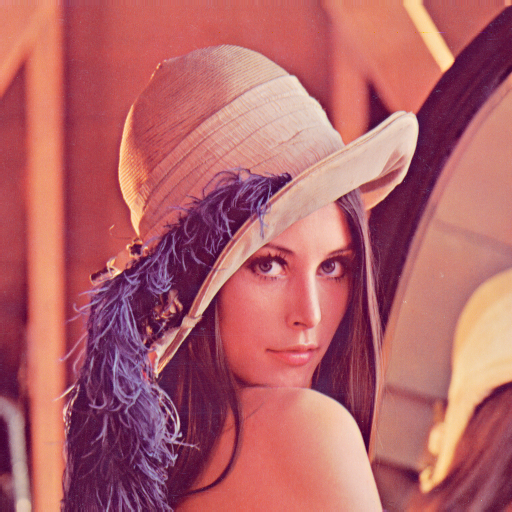

In [ ]:
cv2_imshow(Lena)

### 6 level downsampled gaussian image pyramid of Lena

In [ ]:
Lena_gaussian_pyramid=get_pyramid(Lena,6,gauss_kernel,"down")

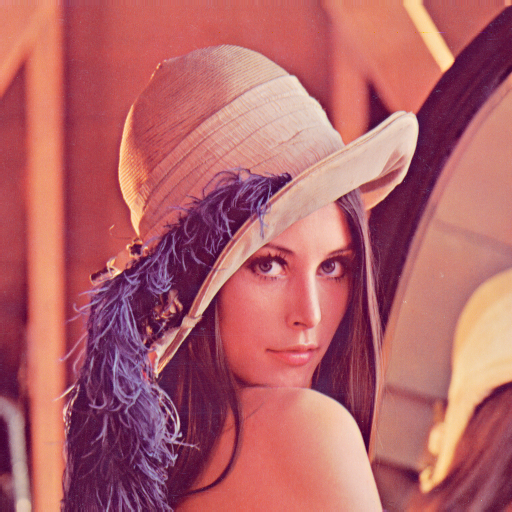

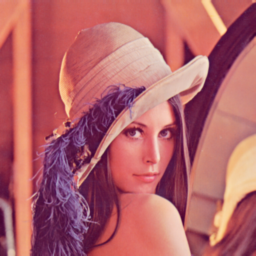

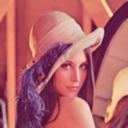

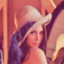

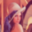

In [ ]:
for key in Lena_gaussian_pyramid.keys():
  cv2_imshow(Lena_gaussian_pyramid[key])

### 5 level laplacian image pyramid of Lena






In [ ]:
Lena_laplacian_pyramid=Laplacian_pyramid(Lena_gaussian_pyramid,gauss_kernel)

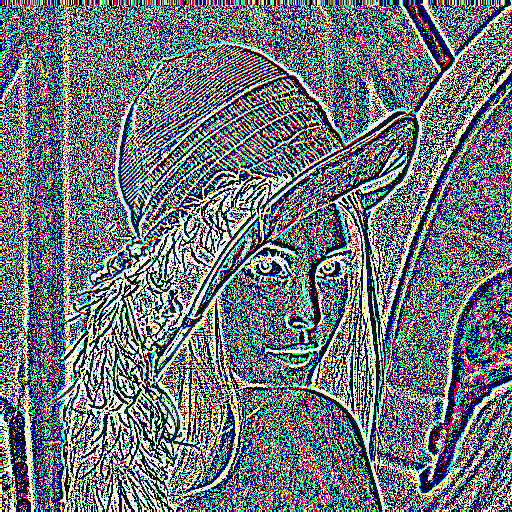

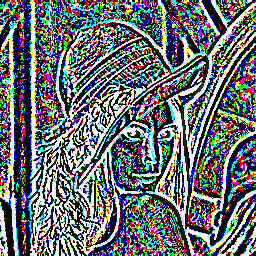

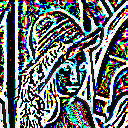

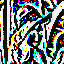

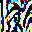

In [ ]:
for key in list(Lena_laplacian_pyramid.keys())[::-1]:
  cv2_imshow(Lena_laplacian_pyramid[key])

### 5 level  reconstructed image pyramid of Lena


In [ ]:
Lena_reconstructed_pyramid=reconstruct_original(Lena_gaussian_pyramid,Lena_laplacian_pyramid,gauss_kernel)

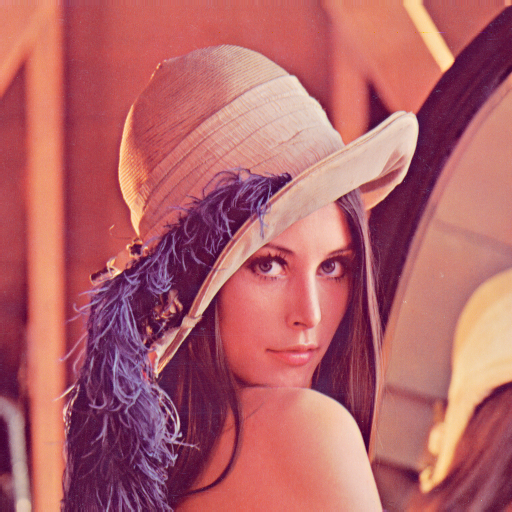

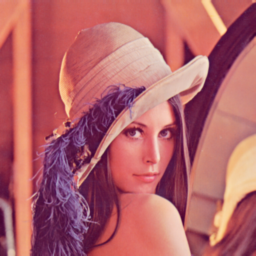

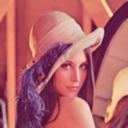

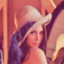

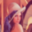

In [ ]:
for key in list(Lena_reconstructed_pyramid.keys())[::-1]:
  cv2_imshow(Lena_reconstructed_pyramid[key])

In [ ]:
for key in list(Lena_reconstructed_pyramid.keys())[::-1]:

  if compare_image(Lena_reconstructed_pyramid[key],Lena_gaussian_pyramid[key-1])==True:
    print("Reconstructed image at level ", key-1, " is same as original.")
  
  elif compare_image(Lena_reconstructed_pyramid[key],Lena_gaussian_pyramid[key-1])==False:
    print("Reconstructed image at level ", key-1, " is not same as original.")

Reconstructed image at level  0  is same as original.
Reconstructed image at level  1  is same as original.
Reconstructed image at level  2  is same as original.
Reconstructed image at level  3  is same as original.
Reconstructed image at level  4  is same as original.


## *Grayscaled Lena*

In [ ]:
grayed_lena=cv.cvtColor(Lena,cv.COLOR_BGR2GRAY)

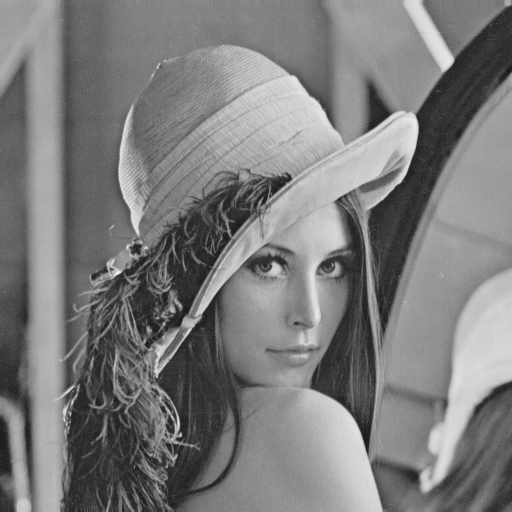

In [ ]:
cv2_imshow(grayed_lena)

### 6 level downsampled gaussian image pyramid of Lena



In [ ]:
gray_lena_gaussian_pyramid=get_pyramid(grayed_lena,6,gauss_kernel,"down")

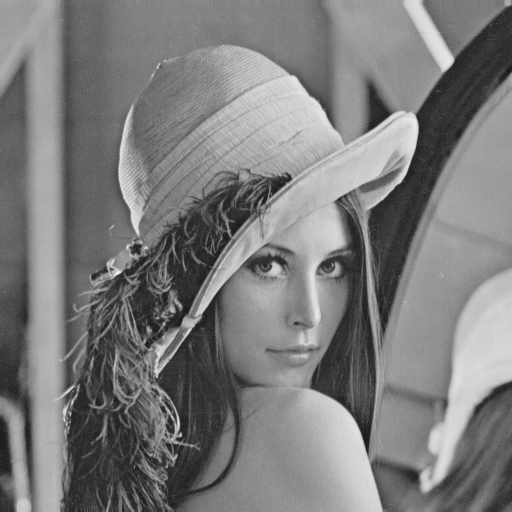

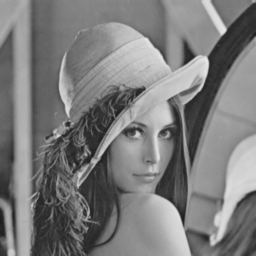

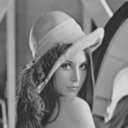

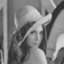

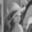

In [ ]:
for key in gray_lena_gaussian_pyramid.keys():
  cv2_imshow(gray_lena_gaussian_pyramid[key])

### 5 level laplacian image pyramid of grayscaled Lena

In [ ]:
gray_lena_laplacian_pyramid=Laplacian_pyramid(gray_lena_gaussian_pyramid,gauss_kernel)

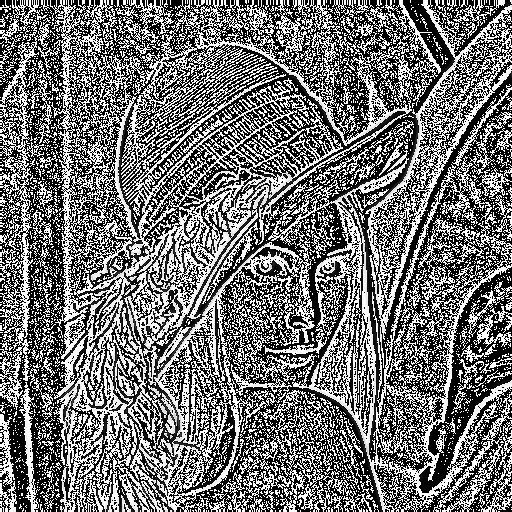

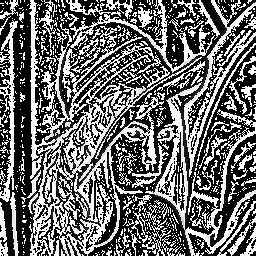

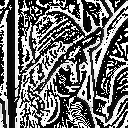

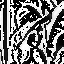

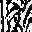

In [ ]:
for key in list(gray_lena_laplacian_pyramid.keys())[::-1]:
  cv2_imshow(gray_lena_laplacian_pyramid[key])

### 5 level  reconstructed image pyramid of grayscaled Lena


In [ ]:
gray_lena_reconstructed_pyramid=reconstruct_original(gray_lena_gaussian_pyramid,gray_lena_laplacian_pyramid,gauss_kernel)

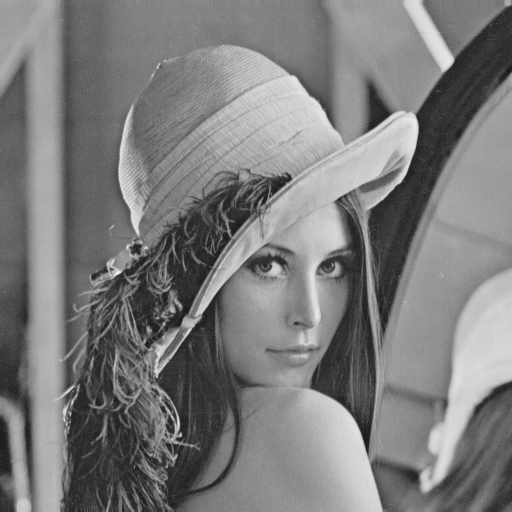

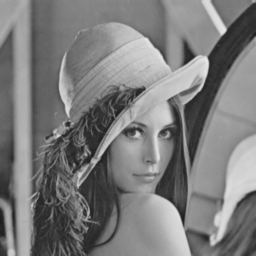

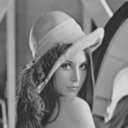

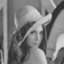

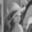

In [ ]:
for key in list(gray_lena_reconstructed_pyramid.keys())[::-1]:
  cv2_imshow(gray_lena_reconstructed_pyramid[key])

In [ ]:
for key in list(gray_lena_reconstructed_pyramid.keys())[::-1]:

  if compare_image(gray_lena_reconstructed_pyramid[key],gray_lena_gaussian_pyramid[key-1])==True:
    print("Reconstructed image at level ", key-1, " is same as original.")
  
  elif compare_image(gray_lena_reconstructed_pyramid[key],gray_lena_gaussian_pyramid[key-1])==False:
    print("Reconstructed image at level ", key-1, " is not same as original.")

Reconstructed image at level  0  is same as original.
Reconstructed image at level  1  is same as original.
Reconstructed image at level  2  is same as original.
Reconstructed image at level  3  is same as original.
Reconstructed image at level  4  is same as original.


## *Parrot*

In [ ]:
parrot=cv.imread("/content/content/My Drive/Data/Images/Pyramids/parrot.png")

In [ ]:
parrot.shape

(340, 453, 3)

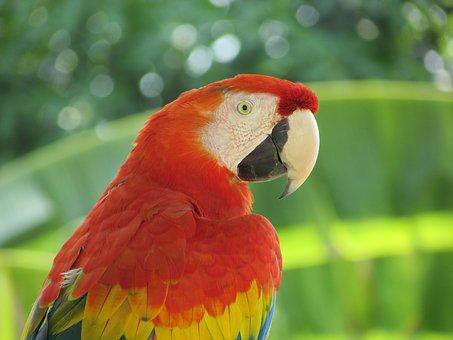

In [ ]:
cv2_imshow(parrot)


### 6 level downsampled gaussian image pyramid of Parrot


In [ ]:
Parrot_gaussian_pyramid=get_pyramid(parrot,6,gauss_kernel,"down")

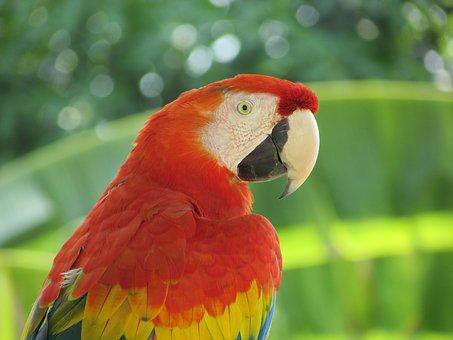

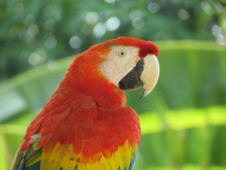

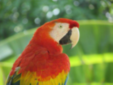

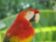

In [ ]:
for key in Parrot_gaussian_pyramid.keys():
  cv2_imshow(Parrot_gaussian_pyramid[key])

### 5 level laplacian image pyramid of Parrot

In [ ]:
Parrot_laplacian_pyramid=Laplacian_pyramid(Parrot_gaussian_pyramid,gauss_kernel)

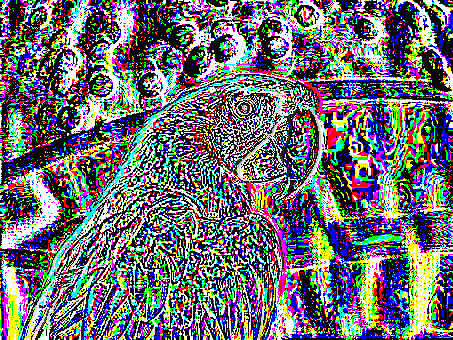

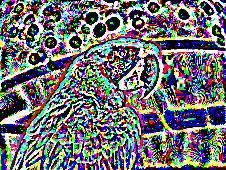

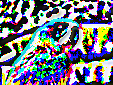

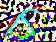

In [ ]:
for key in list(Parrot_laplacian_pyramid.keys())[::-1]:
  cv2_imshow(Parrot_laplacian_pyramid[key])

### 5 level  reconstructed image pyramid of Parrot


In [ ]:
Parrot_reconstructed_pyramid=reconstruct_original(Parrot_gaussian_pyramid,Parrot_laplacian_pyramid,gauss_kernel)

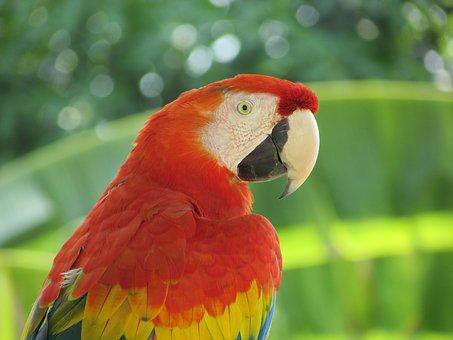

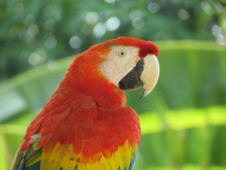

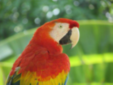

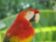

In [ ]:
for key in list(Parrot_reconstructed_pyramid.keys())[::-1]:
  cv2_imshow(Parrot_reconstructed_pyramid[key])

In [ ]:
for key in list(Parrot_reconstructed_pyramid.keys())[::-1]:

  if compare_image(Parrot_reconstructed_pyramid[key],Parrot_gaussian_pyramid[key-1])==True:
    print("Reconstructed image at level ", key-1, " is same as original.")
  
  elif compare_image(Parrot_reconstructed_pyramid[key],Parrot_gaussian_pyramid[key-1])==False:
    print("Reconstructed image at level ", key-1, " is not same as original.")

Reconstructed image at level  0  is same as original.
Reconstructed image at level  1  is same as original.
Reconstructed image at level  2  is same as original.
Reconstructed image at level  3  is same as original.
Reconstructed image at level  4  is same as original.


## *Grayscaled Hill*

In [ ]:
hill=cv.imread("/content/content/My Drive/Data/Images/Pyramids/hill_gray.png")

In [ ]:
hill.shape

(960, 1280, 3)

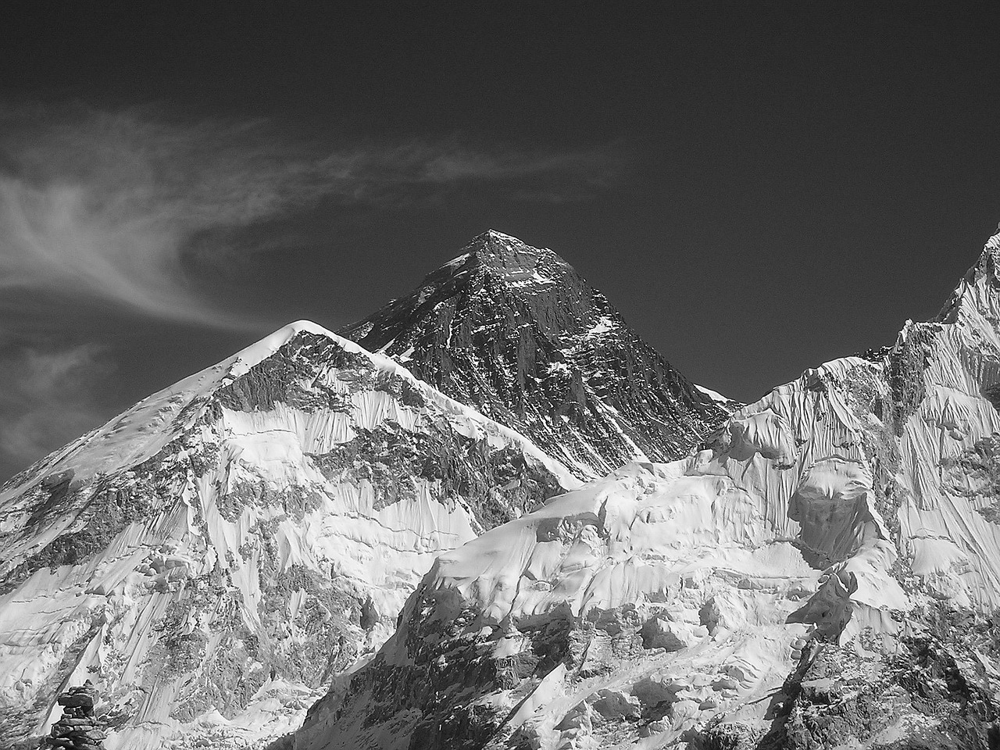

In [ ]:
cv2_imshow(hill)

### 6 level downsampled gaussian image pyramid of grayscaled hill


In [ ]:
hill_gaussian_pyramid=get_pyramid(hill,6,gauss_kernel,"down")

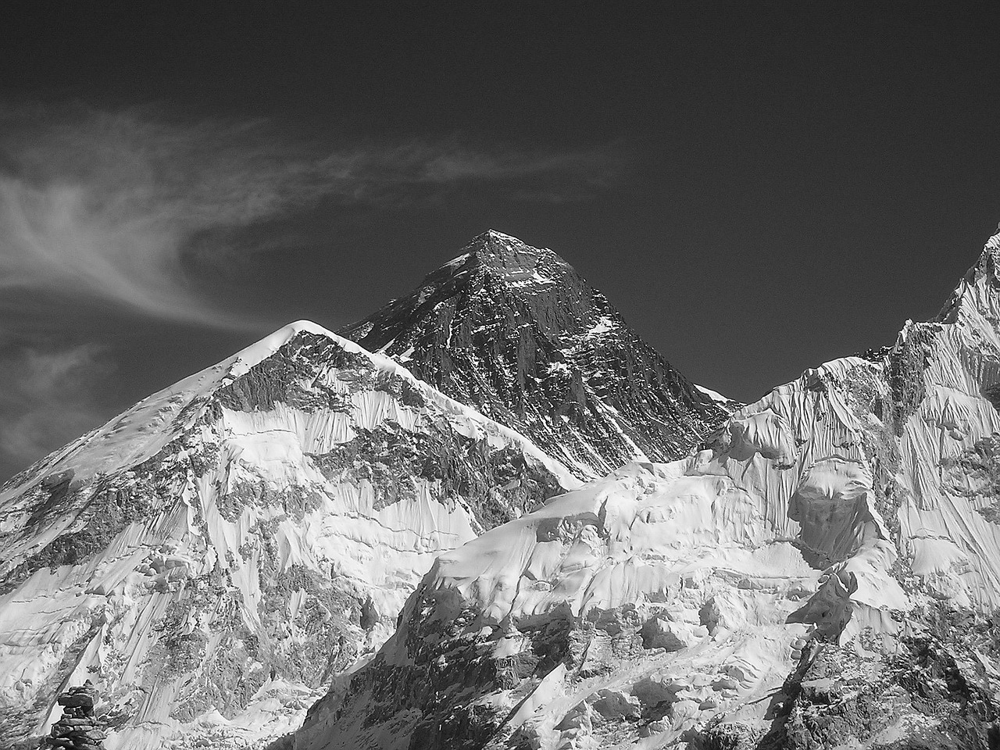

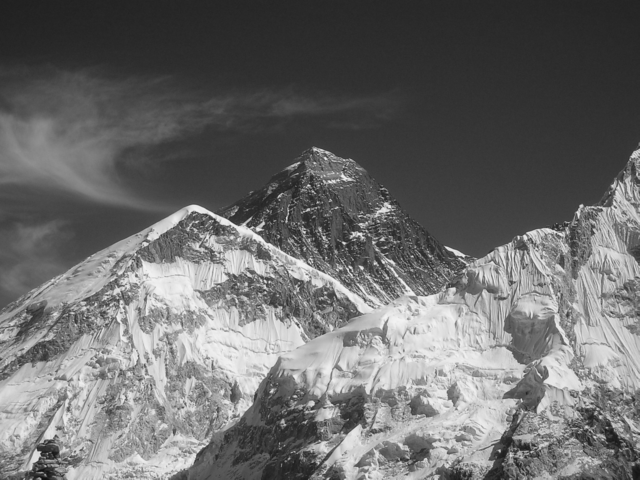

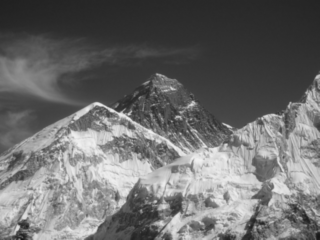

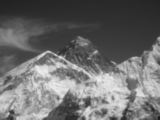

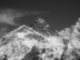

In [ ]:
for key in hill_gaussian_pyramid.keys():
  cv2_imshow(hill_gaussian_pyramid[key])

### 5 level laplacian image pyramid of grayscaled hill

In [ ]:
hill_laplacian_pyramid=Laplacian_pyramid(hill_gaussian_pyramid,gauss_kernel)

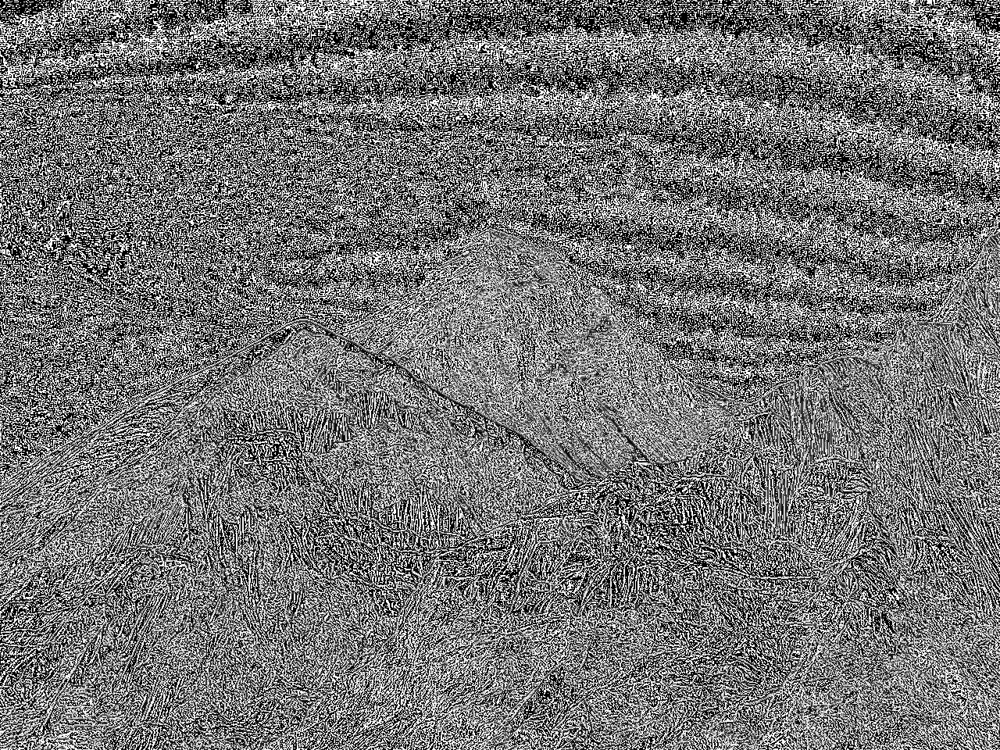

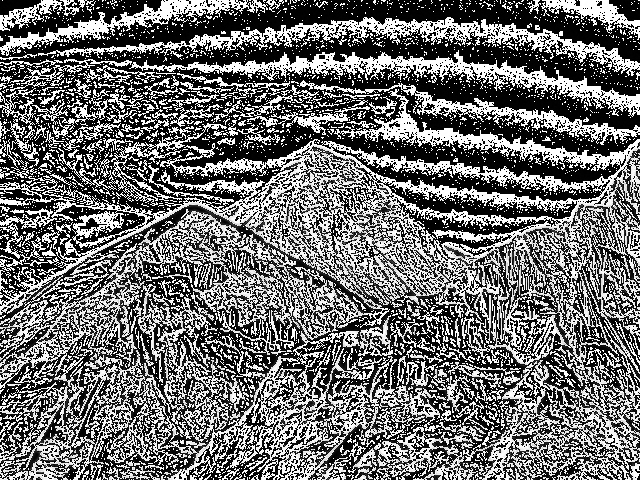

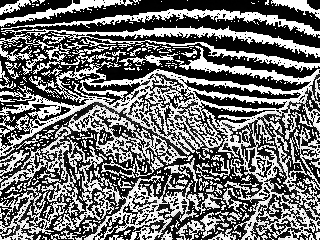

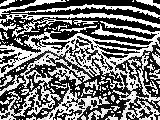

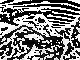

In [ ]:
for key in list(hill_laplacian_pyramid.keys())[::-1]:
  cv2_imshow(hill_laplacian_pyramid[key])

### 5 level  reconstructed image pyramid of grayscaled hill





In [ ]:
hill_reconstructed_pyramid=reconstruct_original(hill_gaussian_pyramid,hill_laplacian_pyramid,gauss_kernel)

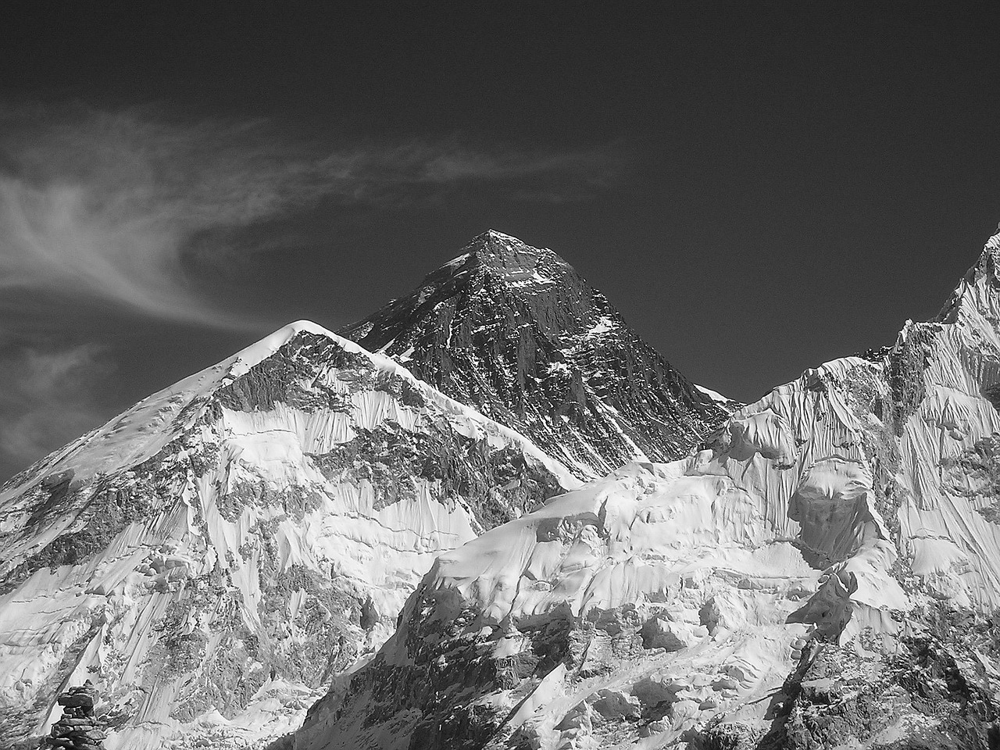

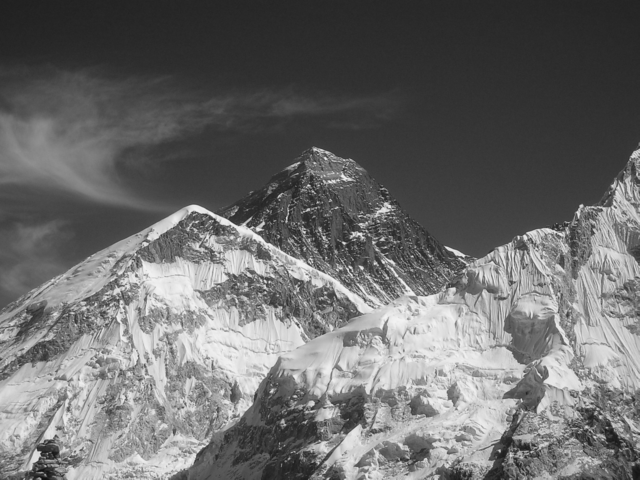

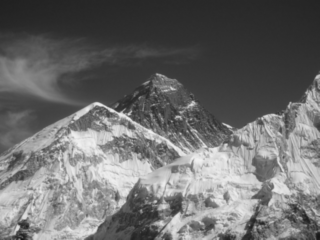

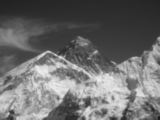

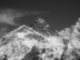

In [ ]:
for key in list(hill_reconstructed_pyramid.keys())[::-1]:
  cv2_imshow(hill_reconstructed_pyramid[key])

In [ ]:
for key in list(hill_reconstructed_pyramid.keys())[::-1]:

  if compare_image(hill_reconstructed_pyramid[key],hill_gaussian_pyramid[key-1])==True:
    print("Reconstructed image at level ", key-1, " is same as original.")
  
  elif compare_image(hill_reconstructed_pyramid[key],hill_gaussian_pyramid[key-1])==False:
    print("Reconstructed image at level ", key-1, " is not same as original.")

Reconstructed image at level  0  is same as original.
Reconstructed image at level  1  is same as original.
Reconstructed image at level  2  is same as original.
Reconstructed image at level  3  is same as original.
Reconstructed image at level  4  is same as original.


## *Cameraman*

In [ ]:
cameraman=cv.imread("/content/content/My Drive/Data/Images/Pyramids/cameraman.jpg")

In [ ]:
cameraman.shape

(256, 256, 3)

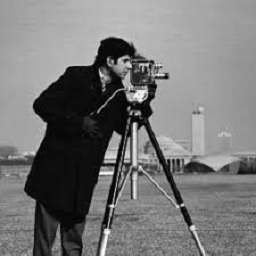

In [ ]:
cv2_imshow(cameraman)

### 6 level downsampled gaussian image pyramid of cameraman


In [ ]:
cameraman_gaussian_pyramid=get_pyramid(cameraman,6,gauss_kernel,"down")

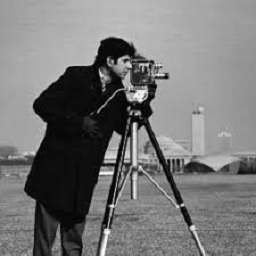

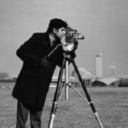

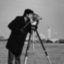

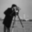

In [ ]:
for key in cameraman_gaussian_pyramid.keys():
  cv2_imshow(cameraman_gaussian_pyramid[key])

### 5 level laplacian image pyramid of cameraman

In [ ]:
cameraman_laplacian_pyramid=Laplacian_pyramid(cameraman_gaussian_pyramid,gauss_kernel)

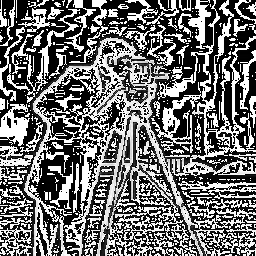

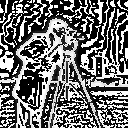

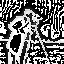

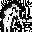

In [ ]:
for key in list(cameraman_laplacian_pyramid.keys())[::-1]:
  cv2_imshow(cameraman_laplacian_pyramid[key])

### 5 level  reconstructed image pyramid of grayscaled hill


In [ ]:
cameraman_reconstructed_pyramid=reconstruct_original(cameraman_gaussian_pyramid,cameraman_laplacian_pyramid,gauss_kernel)

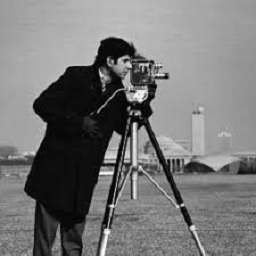

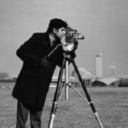

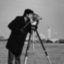

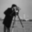

In [ ]:
for key in list(cameraman_reconstructed_pyramid.keys())[::-1]:
  cv2_imshow(cameraman_reconstructed_pyramid[key])

In [ ]:
for key in list(cameraman_reconstructed_pyramid.keys())[::-1]:

  if compare_image(cameraman_reconstructed_pyramid[key],cameraman_gaussian_pyramid[key-1])==True:
    print("Reconstructed image at level ", key-1, " is same as original.")
  
  elif compare_image(cameraman_reconstructed_pyramid[key],cameraman_gaussian_pyramid[key-1])==False:
    print("Reconstructed image at level ", key-1, " is not same as original.")

Reconstructed image at level  0  is same as original.
Reconstructed image at level  1  is same as original.
Reconstructed image at level  2  is same as original.
Reconstructed image at level  3  is same as original.
Reconstructed image at level  4  is same as original.


In [ ]:
def merge_image(image1,image2):
  """
  Parameters:

      image1: Input image 1
      image2: Input image 2

  """
  if image1.shape[0]!=image2.shape[0]:# The rows of the two image must be same
    print("Enter a new pair of images, images should have the same height.")
    return
  try:
      merge_image=[]
      rows,cols1,channels1=image1.shape# since rows of image1 and image 2 are same
      _,cols2,channels2=image2.shape
      if channels1==channels2:
        channels=channels1
        if cols1%2!=0 and cols2%2!=0:
          for channel_num in range(channels):
            temp_image=np.array([list(image1[:,:,channel_num][0])[:cols1//2]+[(image1[:,:,channel_num][0][cols1//2]+image2[:,:,channel_num][0][cols2//2])/2]+list(image2[:,:,channel_num][0])[(cols2//2)+1:]])
            for row in range(1,rows):
              temp=np.array([list(image1[:,:,channel_num][row])[:cols1//2]+[(image1[:,:,channel_num][row][cols1//2]+image2[:,:,channel_num][row][cols2//2])/2]+list(image2[:,:,channel_num][row])[(cols2//2)+1:]])
              temp_image=np.append(temp_image,temp,axis=0)
            merge_image.append(temp_image)
        
        elif cols1%2==0 and cols2%2!=0:
          for channel_num in range(channels):
            temp_image=np.array([list(image1[:,:,channel_num][0])[:cols1//2]+[image2[:,:,channel_num][0][cols2//2]]+list(image2[:,:,channel_num][0])[(cols2//2)+1:]])
            for row in range(1,rows):
              temp=np.array([list(image1[:,:,channel_num][row])[:cols1//2]+[+image2[:,:,channel_num][row][cols2//2]]+list(image2[:,:,channel_num][row])[(cols2//2)+1:]])
              temp_image=np.append(temp_image,temp,axis=0)
            merge_image.append(temp_image)

        elif cols1%2!=0 and cols2%2==0:
          for channel_num in range(channels):
            temp_image=np.array([list(image1[:,:,channel_num][0])[:cols1//2]+[image2[:,:,channel_num][0][cols1//2]]+list(image2[:,:,channel_num][0])[(cols2//2)+1:]])
            for row in range(1,rows):
              temp=np.array([list(image1[:,:,channel_num][row])[:cols1//2]+[+image2[:,:,channel_num][row][cols1//2]]+list(image2[:,:,channel_num][row])[(cols2//2)+1:]])
              temp_image=np.append(temp_image,temp,axis=0)
            merge_image.append(temp_image)

        else:
          for channel_num in range(channels):
            temp_image=np.array([list(image1[:,:,channel_num][0])[:cols1//2]+list(image2[:,:,channel_num][0])[(cols2//2):]])
            for row in range(1,rows):
              temp=np.array([list(image1[:,:,channel_num][row])[:cols1//2]+list(image2[:,:,channel_num][row])[(cols2//2):]])
              temp_image=np.append(temp_image,temp,axis=0)
            merge_image.append(temp_image)
        return cv.merge(merge_image)
      else:
          print("Enter a new pair of image, images should have the same number of channels.")
          return

  except ValueError:# For gray scale image input
      rows,cols1=image1.shape
      _,cols2=image2.shape

      if cols1%2!=0 and cols2%2!=0:
          merged_image=np.array([list(image1[0])[:cols1//2]+[(image1[0][cols1//2]+image2[0][cols2//2])/2]+list(image2[0])[(cols2//2)+1:]])
          for row in range(1,rows):
            temp=np.array([list(image1[row])[:cols1//2]+[(image1[row][cols1//2]+image2[row][cols2//2])/2]+list(image2[row])[(cols2//2)+1:]])
            merged_image=np.append(merged_image,temp,axis=0)
      
      elif cols1%2==0 and cols2%2!=0:
          merged_image=np.array([list(image1[0])[:cols1//2]+[image2[0][cols2//2]]+list(image2[0])[(cols2//2)+1:]])
          for row in range(1,rows):
            temp=np.array([list(image1[row])[:cols1//2]+[image2[row][cols2//2]]+list(image2[row])[(cols2//2)+1:]])
            merged_image=np.append(merged_image,temp,axis=0)
      
      elif cols1%2!=0 and cols2%2==0:
          merged_image=np.array([list(image1[0])[:cols1//2]+[image1[0][cols1//2]]+list(image2[0])[(cols2//2)+1:]])
          for row in range(1,rows):
            temp=np.array([list(image1[row])[:cols1//2]+[image2[row][cols1//2]]+list(image2[row])[(cols2//2)+1:]])
            merged_image=np.append(merged_image,temp,axis=0)
      
      else:
          merged_image=np.array([list(image1[0])[:cols1//2]+list(image2[0])[(cols2//2):]])
          for row in range(1,rows):
            temp=np.array([list(image1[row])[:cols1//2]+list(image2[row])[(cols2//2):]])
            merged_image=np.append(temp_image,temp,axis=0)

      return merged_image

In [ ]:
def merge_pyramids(pyramid1,pyramid2):
  """
  Parameters:

      pyramid1: Input pyramid 1
      pyramid2: Input pyramid 2

  """
  merged_pyramid={}
  try:
    pyramid_keys=pyramid1.keys()
    for key in pyramid_keys:
      merged_pyramid[key]= merge_image(pyramid1[key],pyramid2[key])
    
    return merged_pyramid 
  except KeyError:
    print("Pyramids must have same keys.")
    return


### Image 1

In [ ]:
joker=cv.imread("/content/content/My Drive/Data/Images/grab-hold-of-the-beautiful-jared-leto-joker-iphone-wallpaper-of-jared-leto-joker-iphone-wallpaper.png.jpeg")

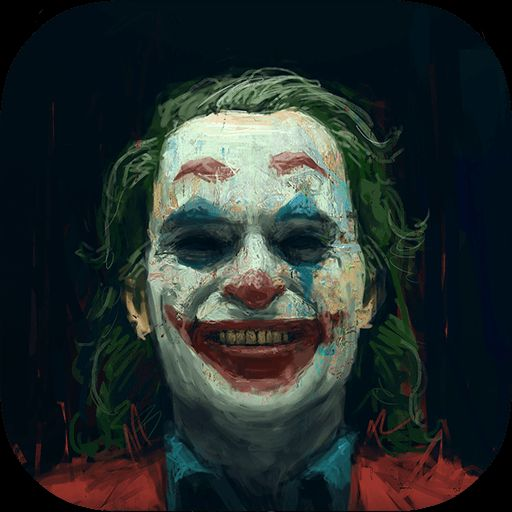

In [ ]:
cv2_imshow(joker)

### Gaussian Pyramid of Image 1

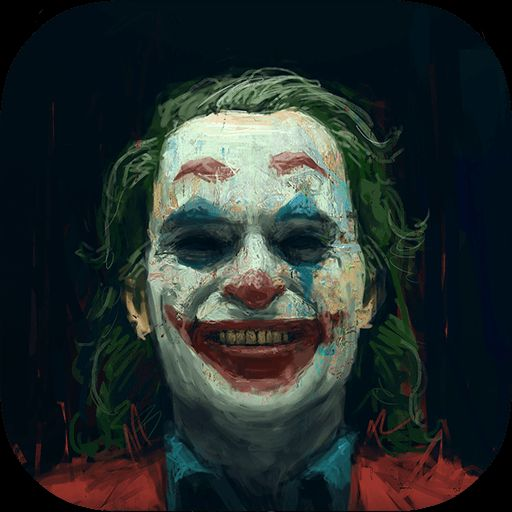

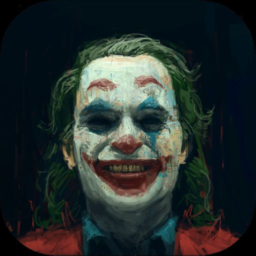

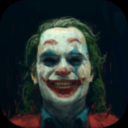

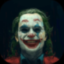

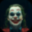

In [ ]:
joker_gaussian_pyramid=get_pyramid(joker,5,gauss_kernel,"down")
for key in joker_gaussian_pyramid.keys():
  cv2_imshow(joker_gaussian_pyramid[key])

## Laplacian Pyramid for Image 1

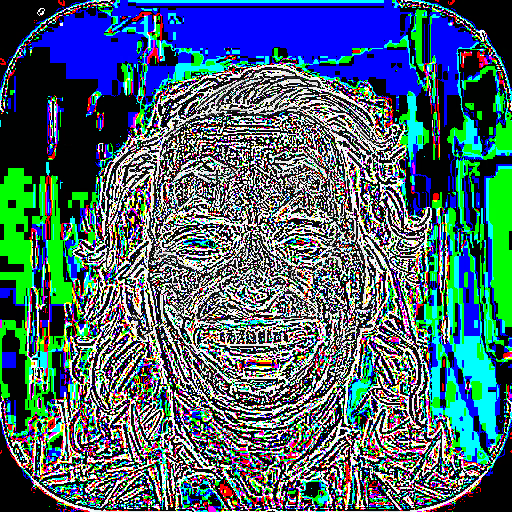

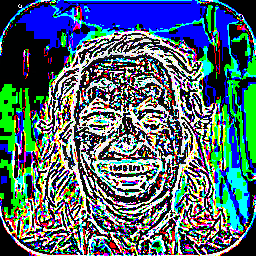

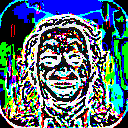

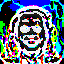

In [ ]:
joker_laplacian_pyramid=Laplacian_pyramid(joker_gaussian_pyramid,gauss_kernel)
for key in list(joker_laplacian_pyramid.keys())[::-1]:
  cv2_imshow(joker_laplacian_pyramid[key])

## Image 2

In [ ]:
joaquin =cv.imread("/content/content/My Drive/Data/Images/unnamed.jpg")

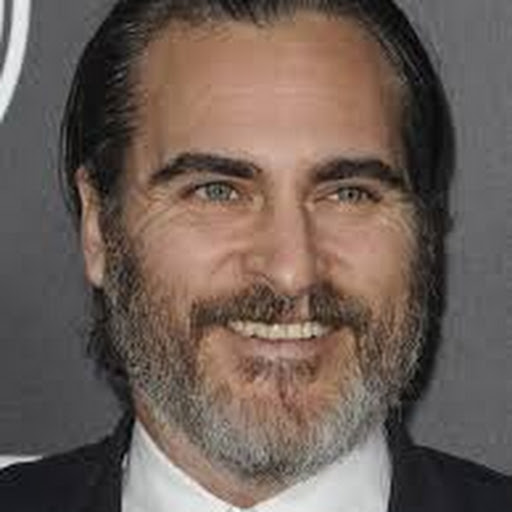

In [ ]:
cv2_imshow(joaquin)

## Gaussian Pyramid for Image 2




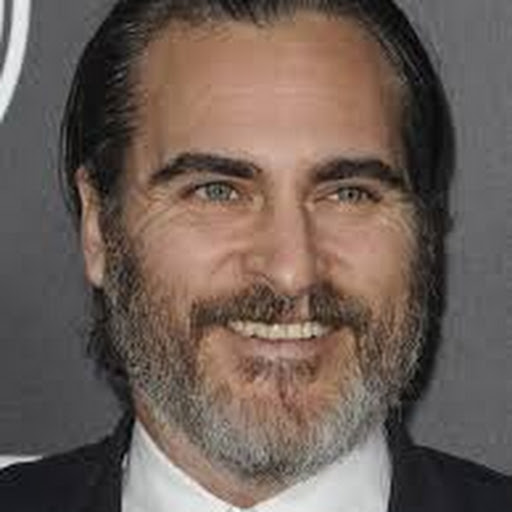

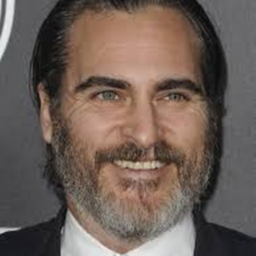

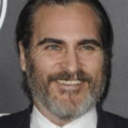

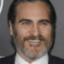

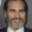

In [ ]:
joaquin_gaussian_pyramid=get_pyramid(joaquin,5,gauss_kernel,"down")
for key in list(joaquin_gaussian_pyramid.keys()):
  cv2_imshow(joaquin_gaussian_pyramid[key])

## Laplacian Pyramid of Image2

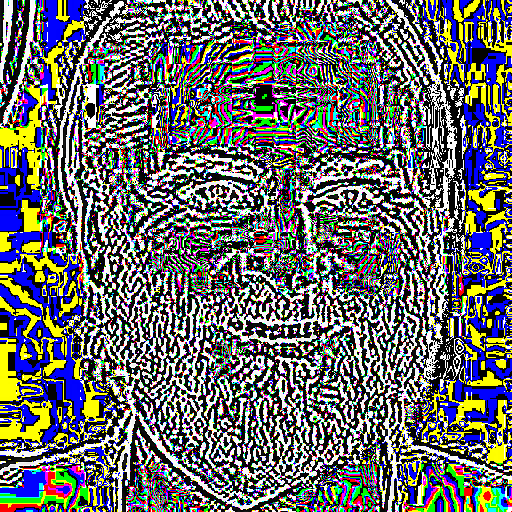

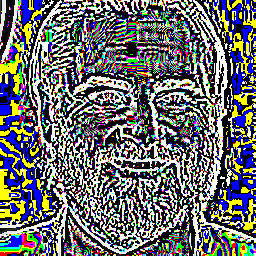

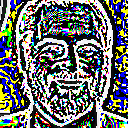

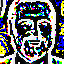

In [ ]:
joaquin_laplacian_pyramid=Laplacian_pyramid(joaquin_gaussian_pyramid,gauss_kernel)
for key in list(joaquin_laplacian_pyramid.keys())[::-1]:
  cv2_imshow(joaquin_laplacian_pyramid[key])

### Merge image

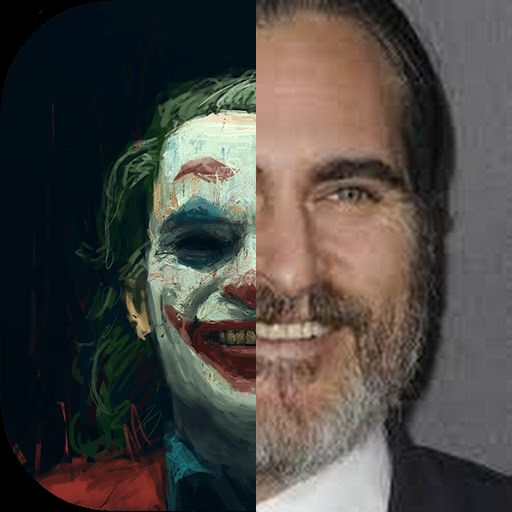

In [ ]:
cv2_imshow(merge_image(joker,joaquin))

## Merged Gaussian Pyramid obtained by merging gaussian pyramid of images 1 and 2


In [ ]:
joker_joaquin_merge_gaussian=merge_pyramids(joker_gaussian_pyramid,joaquin_gaussian_pyramid)

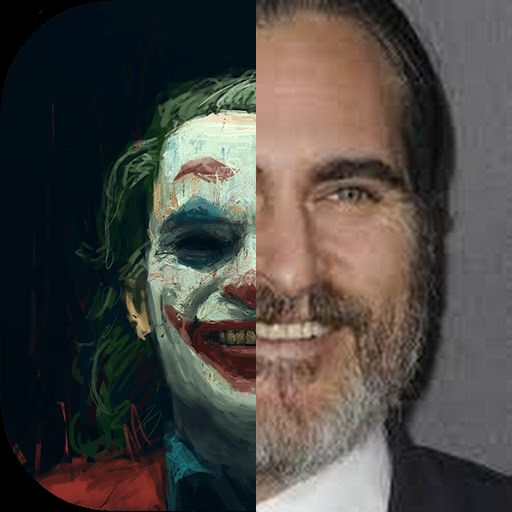

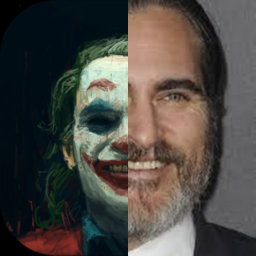

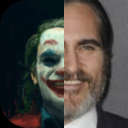

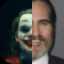

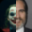

In [ ]:
for key in joker_joaquin_merge_gaussian.keys():
  cv2_imshow(joker_joaquin_merge_gaussian[key])

## Merged Laplacian Pyramid obtained by merging laplacian pyramid of images 1 and 2


In [ ]:
joker_joaquin_merge_laplacian=merge_pyramids(joker_laplacian_pyramid,joaquin_laplacian_pyramid)

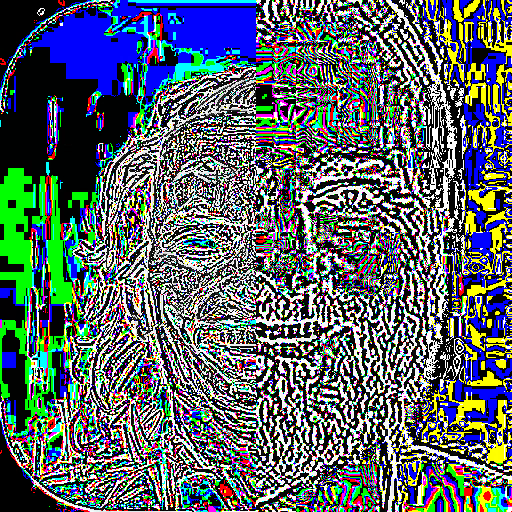

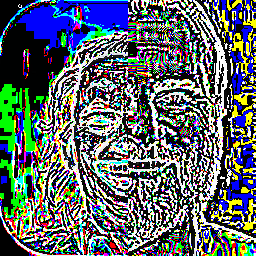

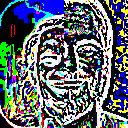

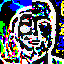

In [ ]:
for key in list(joker_joaquin_merge_laplacian.keys())[::-1]:
  cv2_imshow(joker_joaquin_merge_laplacian[key])

## Reconstructed gaussian pyramid of the merged gaussian pyramid

In [ ]:
joker_joaquin_merge_reconstruct=reconstruct_original(joker_joaquin_merge_gaussian,joker_joaquin_merge_laplacian,gauss_kernel)

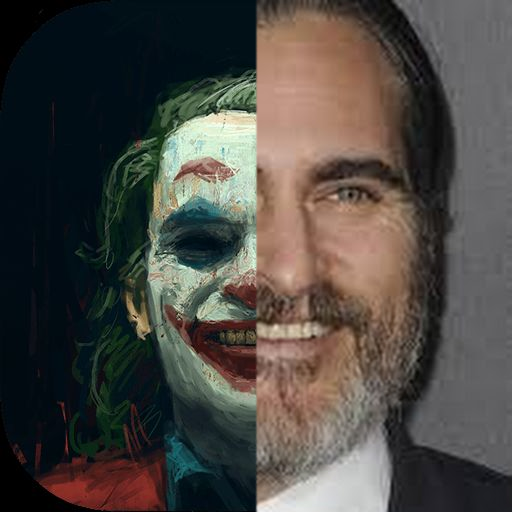

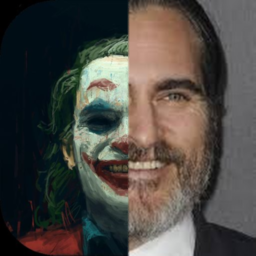

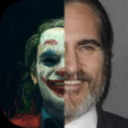

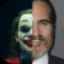

In [ ]:
for key in list(joker_joaquin_merge_reconstruct.keys())[::-1]:
  cv2_imshow(joker_joaquin_merge_reconstruct[key])